Voici mon notebook pour le challenge que m'a proposé l'entreprise [SoyHuce](https://soyhuce.fr/) pour son recrutement.

J'ai eu quatre jours pour faire ce challenge. Étant donné que je suis étudiant, j'ai travaillé entre les cours.

<br/>

L'objectif du projet est d'aider des scientifiques d'un laboratoire de Normandie à identifier les baleines qu'ils rencontrent en mer.

Pour cela, j'ai à ma disposition un [jeu de données](https://www.kaggle.com/c/humpback-whale-identification/overview) composé d'une dizaine de milliers de photos de baleines, chacune identifiée par son id ou le label new_whale si c'est une baleine non indentifiée.

<br/>

J'ai commencé par analyser le jeu de données et visualiser les photos. Je les ai ensuite mis en forme pour les donner à mon modèle. Mon modèle est un réseau de neurones à convolution, une architecture spécialisée pour la reconnaissance d'images. Enfin, j'ai essayé d'améliorer la performance en développant un modèle en apprentissage par transfert.
  

<br/>

Durant ce projet, j'ai utilisé les frameworks suivants :

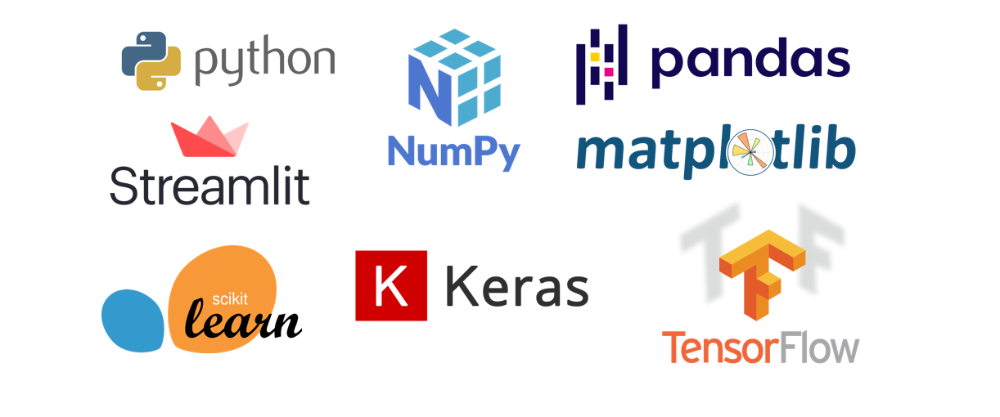

* Le langage de programmation **Python**
* **Numpy** et **Pandas** pour la manipulation et l'analyse des données
* **Matplotlib** pour visualiser les photos de baleines
* **Tensorflow** et **Keras** pour la création de modèles de machine learning 
* **Streamlit** pour mettre en production le modèle et créer une application web
* Quelques fonctions de **Scikit-learn** pour redimensionner les images dans mon application

# I. Importation des bibliothèques

Commençons par les importations des différentes bibliothèques nécessaires au projet.

In [15]:
import random # Pour tirer au hasard des images
import os # Accès aux fonctions systèmes 
from pathlib import Path # Accès aux répertoires

import matplotlib.pyplot as plt # Visualisation de données
import matplotlib.image as mpimg # Manipulation d'images
from PIL import Image # Manipulation d'images

import pandas as pd # Traitement et analyse de données
import numpy as np # Manipulation de matrices

from tensorflow import keras # Création de modèles de machine learning
from keras.preprocessing.image import ImageDataGenerator # Traitements sur les images

# II. Visualisation du jeu de données

Je commence par visualiser les images du jeu d'entraînement pour vérifier qu'elles sont bien toutes différentes.

Je constate qu'elles ont des tailles variables et que certaines sont en noir et blanc. 

Il y a quelques photos représentant une tête de baleine. Avec ces dernières, il sera difficile d'identifier la baleine étant donné que le modèle est entraîné pour idendifier les baleines par leur queue.

In [20]:
rows, cols = 3, 3 # 9 images
axes=[]
fig=plt.figure(figsize=(125,125)) # Taille des images
imgdir = Path('Train/') # Les images se trouvent dans le répertoire Train

for indice_fig in range(rows*cols):
    name_file = random.choice(os.listdir(imgdir)) # Lecture aléatoire dans le répertoire
    img = mpimg.imread('Train/' + name_file)
    axes.append(fig.add_subplot(rows, cols, indice_fig+1))
    plt.imshow(img)
fig.tight_layout()    
plt.show()

# III. Analyse exploratoire des données

J'importe le fichier *train.csv* pour avoir une vue d'ensemble du jeu de données.

Je constate que j'ai à disposition 9 850 images. Chacune d'entre elles représente une baleine.

Il y a 4 251 baleines représentées à travers ce jeu de données. Cependant, la grandre majorité d'entre elles (88%) sont représentées par une, deux ou trois photos.

Enfin, 810 photos correspondent à de nouvelles baleines (qui n'ont pas été identifiées). Ces dernières représentent 8.2% du jeu de données. 

L'objectif de mon modèle est donc de dépasser la performance du modèle le plus naïf qui consisterait à identifier chaque baleine comme une nouvelle baleine (new_whale).

In [32]:
data = pd.read_csv('train.csv') # Création d'un dataframe pandas à partir du fichier train.csv

print(f'Dimension du fichier train.csv : {data.shape[0]} lignes et {data.shape[1]} colonnes')

print('\n____________________________________________\n')
print('10 premières lignes du fichier train.csv :\n', data.head(10))

print('\n____________________________________________\n')
print('Répartition du nombre de photos par baleine :')
df1 = data['Id'].value_counts()
df2 = round(data['Id'].value_counts(normalize=True)*100, 3)
print(pd.merge(df1, df2, left_index=True, right_index=True).rename(columns={'Id_x': 'Nombre photos', 
                                                                            'Id_y': '%'})) # Score à battre : 8.2% (new_whale)

print('\n____________________________________________\n')
nb_id = len(df1.values)
print(f'Nombre de baleines : {nb_id}')
print(f'Nombre de baleines représentées par une photo : {len(df1[df1.values == 1])} ({round(len(df1[df1.values == 1])/nb_id,2)*100}%)')
print(f'Nombre de baleines représentées par deux photos : {len(df1[df1.values == 2])} ({round(len(df1[df1.values == 2])/nb_id,2)*100}%)')
print(f'Nombre de baleines représentées par trois photos : {len(df1[df1.values == 3])} ({round(len(df1[df1.values == 3])/nb_id,2)*100}%)')

Dimension du fichier train.csv : 9850 lignes et 2 colonnes

____________________________________________

10 premières lignes du fichier train.csv :
           Image         Id
0  00022e1a.jpg  w_e15442c
1  000466c4.jpg  w_1287fbc
2  00087b01.jpg  w_da2efe0
3  001296d5.jpg  w_19e5482
4  0014cfdf.jpg  w_f22f3e3
5  0025e8c2.jpg  w_8b1ca89
6  0026a8ab.jpg  w_eaad6a8
7  0031c258.jpg  new_whale
8  0035632e.jpg  w_3d0bc7a
9  0037e7d3.jpg  w_50db782

____________________________________________

Répartition du nombre de photos par baleine :
           Nombre photos      %
new_whale            810  8.223
w_1287fbc             34  0.345
w_98baff9             27  0.274
w_7554f44             26  0.264
w_1eafe46             23  0.234
...                  ...    ...
w_f801078              1  0.010
w_00c4901              1  0.010
w_f9d27ad              1  0.010
w_0dac526              1  0.010
w_18bd7b3              1  0.010

[4251 rows x 2 columns]

____________________________________________

Nomb

# IV. Visualisation de la baleine la plus représentée dans le jeu de données

À la suite de l'analyse exploratoire, j'ai pu voir que l'individu *w_1287fbc* est le plus représenté, avec 34 photos.

J'ai donc envie de voir à quoi il ressemble. 

De plus, je vérifie que toutes les photos liées à l'identifiant *w_1287fbc* représentent bien la même baleine.

Baleine : w_1287fbc


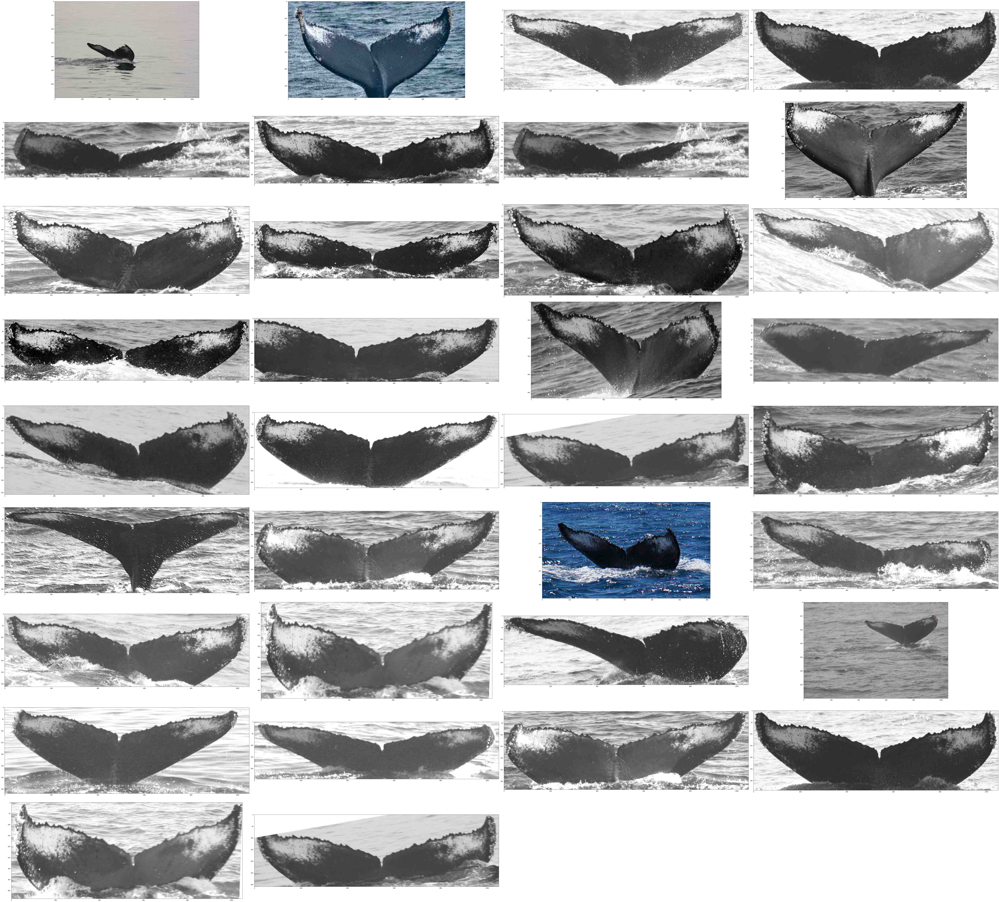

In [29]:
# Visualisation de la baleine la plus représentée : w_1287fbc
rows, cols = 10, 4
axes=[]
fig=plt.figure(figsize=(100,100)) # Taille des images

print('Baleine : w_1287fbc')

for indice_fig, name_file in enumerate(data[data['Id'] == 'w_1287fbc']['Image']):
    b = mpimg.imread('Train/' + name_file)
    axes.append(fig.add_subplot(rows, cols, indice_fig+1) )
    plt.imshow(b)
fig.tight_layout()    
plt.show()

# V. Traitement des images et augmentation des données

Avant de créer un modèle et de l'entrainer sur les images de baleines, il faut faire quelques traitements sur ces dernières.

Tout d'abord, il faut que chaque image ait la même dimension. Je décide de choisir la taille 224x224 pixels qui est une dimension standard pour les images. De plus, c'est souvent la dimension requise pour faire de l'apprentissage par transfert.

J'effectue ensuite des modifications aléatoires à chaque image afin d'apporter un peu plus de diversité au jeu de données. Cela permet d'avoir un modèle qui généralise mieux et donc qui est plus performant sur de nouvelles données. Ces types de modifications sur les images se nomme augmentation de données (*data augmentation* en anglais). Ces modifications sont constituées de zooms, de rotations et de translations.

In [30]:
# Ajout d'une colonne du chemin vers les images
data['Fichier'] = 'Train/' + data['Image']

# Pre-processing des images et data augmentation
height, width = 224, 224 # Les images ont des tailles différentes donc on prend 224x224 pixels
channel = 3 # RGB
batch_size = 64

# Training generator
train_datagen = ImageDataGenerator(rescale=1./255, 
                                   rotation_range=10, 
                                   width_shift_range=0.2, 
                                   height_shift_range=0.2, 
                                   shear_range=0.2,
                                   zoom_range=0.2, 
                                   horizontal_flip=True, 
                                   fill_mode='nearest',
                                   validation_split=0.1)
                                   # 10% de données pour la jeu de validation est suffissant 

train_generator = train_datagen.flow_from_dataframe(dataframe=data,
                                                    directory=None,
                                                    x_col="Fichier",
                                                    y_col="Id",
                                                    target_size=(height,width), # Taille pour redimensionner
                                                    batch_size=batch_size,
                                                    seed=1337,
                                                    shuffle=True,
                                                    class_mode='categorical',
                                                    subset='training')

validation_generator = train_datagen.flow_from_dataframe(dataframe=data,
                                                         directory=None,
                                                         x_col="Fichier",
                                                         y_col="Id",
                                                         target_size=(height,width), # Taille pour redimensionner
                                                         batch_size=batch_size,
                                                         seed=1337,
                                                         shuffle=True,
                                                         class_mode='categorical',
                                                         subset='validation')
# Testing generator
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_dataframe(dataframe=data,
                                                  directory=None,
                                                  x_col="Fichier",
                                                  y_col="Id",
                                                  target_size=(height,width), # Taille pour redimensionner
                                                  batch_size=batch_size,
                                                  seed=1337,
                                                  shuffle=False,
                                                  class_mode='categorical')

train_num = train_generator.samples
validation_num = validation_generator.samples
test_num = test_generator.samples

Found 8865 validated image filenames belonging to 4251 classes.
Found 985 validated image filenames belonging to 4251 classes.
Found 9850 validated image filenames belonging to 4251 classes.


In [26]:
print(f'Dimension des images : {train_generator.image_shape}') 

nb_classes = data['Id'].value_counts().shape[0]
print(f'Nombre de baleines recensées : {nb_classes}')

np.save('dict_encodage', train_generator.class_indices) # Sauvegarde du dictionnaire faisant le lien entre la valeur initiale des classes et leur encodage

Dimension des images : (224, 224, 3)
Nombre de baleines recensées : 4251


# VI. Création du modèle

L'architecture du modèle est un *réseau de neurones à convolution*. C'est une architecture spécialisée pour la reconnaissance d'images.

Je ne vais pas présenter dans le détail cette architecture mais en voici les principales composantes :

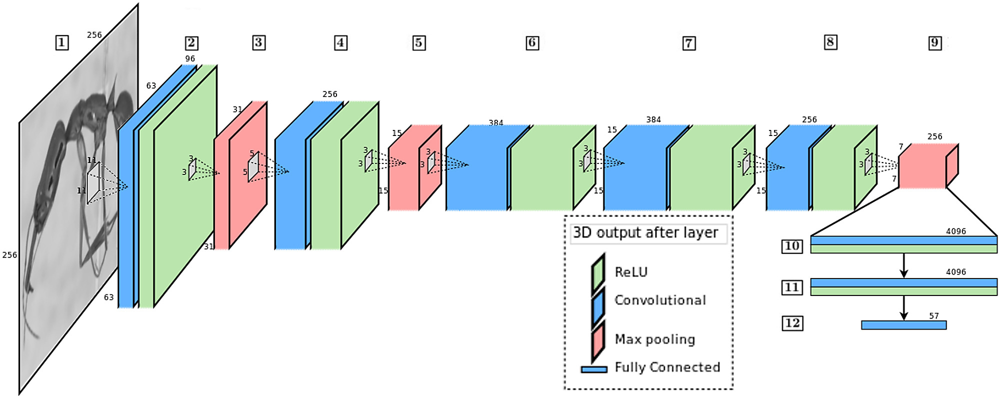

Les réseaux à convolution sont donc définis par une série de 3 éléments :
* Une *convolution* (détection de formes)
* Une *fonction d'activation* (souvent ReLu)
* Un *pooling* (compression de l'information en réduisant la taille de l'image)

Ensuite, il faut redimensioner la sortie sur une seule dimension pour pouvoir y greffer la partie supérieure du réseau de neurones. Cette partie est un réseau de neurones entièrement connectés (aussi appelé réseau dense) qui permet la classification des images.

In [12]:
# Création du modèle    
model = keras.Sequential([
                          keras.layers.Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=(height,width,channel)),
                          keras.layers.MaxPooling2D(pool_size=(2, 2)), 
                          keras.layers.Dropout(0.25),
    
                          keras.layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
                          keras.layers.MaxPooling2D(pool_size=(2, 2)),      
                          keras.layers.Dropout(0.25),
    
                          keras.layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
                          keras.layers.MaxPooling2D(pool_size=(2, 2)),      
                          keras.layers.Dropout(0.25),
   
                          keras.layers.Flatten(),
                          keras.layers.Dense(256, activation='relu'),
                          keras.layers.Dropout(0.5),                          
                          keras.layers.Dense(nb_classes, activation='softmax')
]) # Dropout permet de désactiver des sorties de neurones aléatoirement, de manière à mieux généraliser
 
# Compilation du modèle    
model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['acc'])

early_stopping = keras.callbacks.EarlyStopping(monitor='val_acc',
                                               patience=4, # Stoppe l'entrainement s'il n'y a pas d'amélioration pendant 4 epochs d'affilées
                                               restore_best_weights=True)

# Entrainement du modèle
history = model.fit_generator(train_generator,
                              steps_per_epoch= train_num // batch_size,
                              epochs=200, # Nombre de passes (lecture complète du jeu de données d'entrainement)
                              validation_data=validation_generator,
                              validation_steps= validation_num // batch_size,
                              callbacks=[early_stopping])

Epoch 1/200
138/138 [==============================] - 576s 4s/step - loss: 8.1800 - acc: 0.0800 - val_loss: 8.0739 - val_acc: 0.0823
Epoch 2/200
138/138 [==============================] - 564s 4s/step - loss: 7.8551 - acc: 0.0820 - val_loss: 7.7565 - val_acc: 0.0847
Epoch 3/200
138/138 [==============================] - 560s 4s/step - loss: 7.8023 - acc: 0.0828 - val_loss: 7.7104 - val_acc: 0.0858
Epoch 4/200
138/138 [==============================] - 1083s 8s/step - loss: 7.7721 - acc: 0.0818 - val_loss: 8.5341 - val_acc: 0.0814
Epoch 5/200
138/138 [==============================] - 1147s 8s/step - loss: 7.7671 - acc: 0.0816 - val_loss: 8.3559 - val_acc: 0.0814
Epoch 6/200
138/138 [==============================] - 1046s 8s/step - loss: 7.7379 - acc: 0.0836 - val_loss: 8.8004 - val_acc: 0.0858
Epoch 7/200
138/138 [==============================] - 552s 4s/step - loss: 7.7310 - acc: 0.0809 - val_loss: 8.3942 - val_acc: 0.0879
Epoch 8/200
138/138 [==============================] - 558s

La performance du modèle n'est pas très satisfaisante (8%). 

In [13]:
model.save('model.hdf5') # Sauvegarde du modèle

# VII. Apprentissage par transfert

Mon modèle est surement en *sous-apprentissage*. Cela est dû au fait qu'il a très peu d'exemples par classe sur lesquels apprendre et que la structure du modèle n'est pas assez complexe. Par manque de temps, je ne peux pas complexifier sa structure.  

Pour essayer d'améliorer les performances, je décide d'utiliser un modèle qui a déjà été entraîné sur une immense quantité d'images. Cela s'appelle *l'apprentissage par transfert*. Ainsi, il reste plus qu'à entraîner la partie supérieure du modèle pour l'adapter à notre propre jeu de données.

Voici, une représentation des différents modèles disponibles en apprentissage par transfert. Ils ont des architectures différentes qui influent sur leur performance mais aussi leur taille (nombre de paramètres). 

Je choisis le modèle **DenseNet169** car il possède une taille raisonnable tout en ayant une bonne performance.

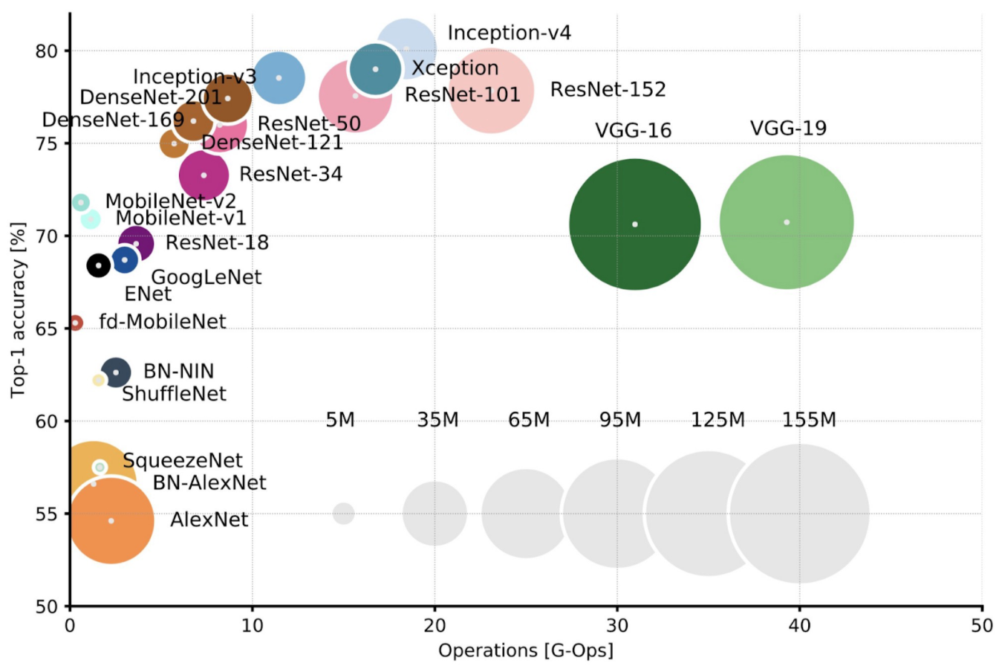

# VIII. Traitement des images et augmentation des données

Encore une fois, je traite les images en les redimensionnant et en faisant de l'augmentation de données.

J'utilise le générateur de données du modèle *DenseNet169* afin qu'il applique les transformations nécessaires pour sa couche de neurones en entrée.

In [20]:
# Pre-processing des images et data augmentation
height, width = 224, 224 # 224x244 pixels (dimensions des images pour DenseNet169)
channel = 3 # RGB
batch_size = 64

# Training generator
train_datagen = ImageDataGenerator(preprocessing_function=keras.applications.densenet.preprocess_input, 
                                   validation_split=0.1)
                                   # 10% de données pour la jeu de validation est suffissant 

train_generator = train_datagen.flow_from_dataframe(dataframe=data,
                                                    directory=None,
                                                    x_col="Fichier",
                                                    y_col="Id",
                                                    target_size=(height,width), # Taille pour redimensionner
                                                    batch_size=batch_size,
                                                    seed=1337,
                                                    shuffle=True,
                                                    class_mode='categorical',
                                                    subset='training')

validation_generator = train_datagen.flow_from_dataframe(dataframe=data,
                                                         directory=None,
                                                         x_col="Fichier",
                                                         y_col="Id",
                                                         target_size=(height,width), # Taille pour redimensionner
                                                         batch_size=batch_size,
                                                         seed=1337,
                                                         shuffle=True,
                                                         class_mode='categorical',
                                                         subset='validation')
# Testing generator
test_datagen = ImageDataGenerator(preprocessing_function=keras.applications.densenet.preprocess_input)

test_generator = test_datagen.flow_from_dataframe(dataframe=data,
                                                  directory=None,
                                                  x_col="Fichier",
                                                  y_col="Id",
                                                  target_size=(height,width), # Taille pour redimensionner
                                                  batch_size=batch_size,
                                                  seed=1337,
                                                  shuffle=False,
                                                  class_mode='categorical')

train_num = train_generator.samples
validation_num = validation_generator.samples
test_num = test_generator.samples

Found 8865 validated image filenames belonging to 4251 classes.
Found 985 validated image filenames belonging to 4251 classes.
Found 9850 validated image filenames belonging to 4251 classes.


# IX. Création du modèle par apprentissage par transfert

Je gèle les couches de convolutions du modèle pour accélérer grandement l'apprentissage.

Je greffe ensuite des couches de neurones entièrement connectés pour que l'entrainement permette d'adapter le modèle *DenseNet169* à mon problème d'identification de baleines. 

In [21]:
pre_trained_model = keras.applications.DenseNet169(input_shape=(224,224,3),
                                                   include_top=False,
                                                   weights="imagenet")
# Gel des couches
for layer in pre_trained_model.layers:
    if 'conv5' in layer.name:
        layer.trainable = True
    else:
        layer.trainable = False
    
# Création du modèle    
model_DensetNet169 = keras.Sequential([
                          pre_trained_model,
                          keras.layers.Flatten(),
                          keras.layers.Dense(256, activation='relu'),
                          keras.layers.Dropout(0.5),
                          keras.layers.Dense(128, activation='relu'),
                          keras.layers.Dropout(0.5),
                          keras.layers.Dense(nb_classes, activation='softmax')
])

# Compilation du modèle
model_DensetNet169.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['acc'])

early_stopping = keras.callbacks.EarlyStopping(monitor='val_acc',
                                              patience=2, # Stoppe l'entrainement s'il n'y a pas d'amélioration pendant 2 epochs d'affilées
                                              restore_best_weights=True)

# Entrainement du modèle
history = model_DensetNet169.fit_generator(train_generator,
                              steps_per_epoch= train_num // batch_size,
                              epochs=50, # Nombre de passes (lecture complète du jeu de données d'entrainement)
                              validation_data=validation_generator,
                              validation_steps= validation_num // batch_size,
                              callbacks=[early_stopping])

51879936/51877672 [==============================] - 38s 1us/step
Epoch 1/50
138/138 [==============================] - 8533s 62s/step - loss: 8.3919 - acc: 0.0742 - val_loss: 8.3219 - val_acc: 0.0823
Epoch 2/50
138/138 [==============================] - 6946s 50s/step - loss: 8.2191 - acc: 0.0815 - val_loss: 8.2631 - val_acc: 0.0836
Epoch 3/50
138/138 [==============================] - 7813s 57s/step - loss: 7.9567 - acc: 0.0828 - val_loss: 8.4518 - val_acc: 0.0814
Epoch 4/50
138/138 [==============================] - 8151s 59s/step - loss: 7.7762 - acc: 0.0817 - val_loss: 8.4900 - val_acc: 0.0869
Epoch 5/50
138/138 [==============================] - 7022s 51s/step - loss: 7.7370 - acc: 0.0825 - val_loss: 8.2945 - val_acc: 0.0814
Epoch 6/50
138/138 [==============================] - 6776s 49s/step - loss: 7.7303 - acc: 0.0814 - val_loss: 8.1392 - val_acc: 0.0890
Epoch 7/50
138/138 [==============================] - 7411s 54s/step - loss: 7.7229 - acc: 0.0827 - val_loss: 8.5065 - val_a

Comme le modèle de réseau de neurones à convolution précédent, la performance de ce modèle plafonne à 9% de bonnes prédictions.

C'est donc très légérement au-dessus des 8.2% du modèle naïf. 

Cependant, ce n'est pas du tout suffisant. Je donnerai dans la dernière partie de ce notebook des pistes pour améliorer cette performance.

In [22]:
model_DensetNet169.save('model_DensetNet169.hdf5') # Sauvegarde du modèle

# X. Mise en production du modèle

Pour finir, je mets en production mon modèle avec le framework [Streamlit](https://www.streamlit.io/).

Pour cela, je crée une application web que vous pouvez retrouver avec le lien suivant : [Identification de baleines](https://share.streamlit.io/thibaultlanthiez/streamlit_app_soyhuce/main/myapp.py)

Cette application permet au client de charger une image depuis un répertoire local puis de la passer au modèle afin qu'il fasse l'inférence.

Je vous montrerai la version locale de cette application pendant notre réunion. Elle est plus complète que la version mise en production.

En effet, la version mise en production ne permet pas de faire de l'inférence. Cela est dû au fait que j'héberge mon application via *GitHub* et que je n'ai pas pu charger le modèle sur le git car il été trop volumineux. J'ai pourtant essayé avec la version [git lfs](https://git-lfs.github.com/) de git mais cela n'a pas marché.

Enfin, il est important de préciser au client qu'il aurait aussi été possible de développer cette application sur des téléphones (avec *TensorFlow Lite*) ou sur des systèmes embarqués (avec *TensorFlow Micro*). Cela peut être utile pour faire rapidement une identification de baleine pendant l'une de leurs expéditions.

Il faut aussi noter qu'il aurait été possible de faire en sorte que lors d'une détection d'une nouvelle baleine, un nouveau identifiant soit associé à la baleine.

# XI. Conclusion et conseils pour le client

Je ne disposais pas de beaucoup de temps pour ce projet (4 jours) mais je pense avoir fait l'essentiel.

Si j'avais eu plus de temps, j'aurais surement essayé de créer un modèle avec le framework *PyTorch* qui est semblable à *Keras*. J'aurais aussi pu chercher à améliorer la performance de mes modèles. 

Bien sûr, si l'objectif du projet avait été de développer un modèle qui détecte si une baleine est connue de la base de données ou inconnue, les performances auraient été bien meilleures. 

Enfin, voici quelques pistes d'amélioration du modèle ainsi que des conseils pour le client :
* Prendre plus de photos de chaque baleine, si possible sous différents angles
* Augmenter le nombre d'images avec de l'augmentation de données pour les baleines très peu représentées
* Utiliser des méthodes d'ensemble learning (combinaison de différents modèles) pour avoir un modèle plus complexe et donc moins sujet au sous-apprentissage

<br/>

# Contact

**Auteur** : Thibault LANTHIEZ

**E-mail** : thibault.lanthiez@outlook.fr

**Téléphone** : 07 50 44 98 05